## Geo3D M 6.5 Monte Cristo Range Earthquake 2020-05-15

The PyGMTSAR InSAR library, Geo3D Geophysical Inversion Library, N-Cube 3D/4D GIS Data Visualization, among others, are my open-source projects developed in my free time. I hold a Master's degree in STEM, specializing in radio physics. In 2004, I received the first prize in the All-Russian Physics Competition for significant results in forward and inverse modeling for nonlinear optics and holography. These skills are also applicable to modeling Gravity, Magnetic, and Thermal fields, as well as satellite interferometry processing. With 20 years of experience as a data scientist and software developer, I have contributed to scientific and industrial development, working on government contracts, university projects, and with companies like LG Corp and Google Inc.

You can support my work on [Patreon](https://www.patreon.com/pechnikov), where I share updates on my projects, publications, use cases, examples, and other useful information. For research and development services and support, please visit my profile on the freelance platform [Upwork](https://www.upwork.com).

### Resources
- Google Colab Pro notebooks and articles on [Patreon](https://www.patreon.com/pechnikov),
- Google Colab notebooks on [GitHub](https://github.com),
- Docker Images on [DockerHub](https://hub.docker.com),
- Geological Models on [YouTube](https://www.youtube.com),
- VR/AR Geological Models on [GitHub](https://github.com),
- Live updates and announcements on [LinkedIn](https://www.linkedin.com/in/alexey-pechnikov/).

© Alexey Pechnikov, 2024

$\large\color{blue}{\text{Hint: Use menu Cell} \to \text{Run All or Runtime} \to \text{Complete All or Runtime} \to \text{Run All}}$
$\large\color{blue}{\text{(depending of your localization settings) to execute the entire notebook}}$

## Google Colab Installation

In [ ]:
import sys
if 'google.colab' in sys.modules:
    !apt-get update > /dev/null && apt install gdal-bin > /dev/null
    !{sys.executable} -m pip install -q matplotlib >/dev/null
    !{sys.executable} -m pip install -q git+https://github.com/AlexeyPechnikov/geo3d.git >/dev/null

In [ ]:
if 'google.colab' in sys.modules:
    !apt install -y xvfb > /dev/null
    !{sys.executable} -m pip install pyvista xvfbwrapper > /dev/null
    import xvfbwrapper
    display = xvfbwrapper.Xvfb(width=800, height=600)
    display.start()

## Load and Setup Python Modules

In [ ]:
import xarray as xr
import rioxarray as rio
import geopandas as gpd
import numpy as np
import os

from matplotlib import cm, colors
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
# plotting modules
import pyvista as pv
# magic trick for white background
pv.set_plot_theme("document")
import panel
panel.extension('vtk')

In [ ]:
import geo3d

# Parameters

In [ ]:
# download data files
!git clone https://github.com/AlexeyPechnikov/geo3d.git

Cloning into 'geo3d'...
remote: Enumerating objects: 145, done.
remote: Counting objects: 100% (69/69), done.
remote: Compressing objects: 100% (53/53), done.
remote: Total 145 (delta 25), reused 55 (delta 15), pack-reused 76
Receiving objects: 100% (145/145), 175.83 MiB | 14.74 MiB/s, done.
Resolving deltas: 100% (53/53), done.
Updating files: 100% (39/39), done.


In [ ]:
  # processing
DEPTH=5000

RESOLUTION = 35
SCALE = 3

GAMMA1=2000/RESOLUTION/SCALE
GAMMA2=3000/RESOLUTION/SCALE

DEM="geo3d/data/ref/USGS_NED_Monte_Cristo_50x50km_35m_32611.tif"
AREA="geo3d/data/ref/Monte_Cristo_AOI_10x10km.32611.geojson"
RASTERS="geo3d/data/ref/COPERNICUS_S1_GRD_Monte_Cristo_Before_50x50km_35m_32611.tif"
#RASTERS="geo3d/data/ref//COPERNICUS_S1_GRD_Monte_Cristo_After_50x50km_35m_32611.tif"
BAND=''

# statistics
#STAT = 'density'
STAT = 'anomaly'

# Load source raster

In [ ]:
raster0 = rio.open_rasterio(RASTERS.format(BAND)).squeeze().astype(float)\
    .coarsen({'y': SCALE, 'x': SCALE}, boundary='trim').mean()
if '_FillValue' in raster0.attrs:
    raster0.values[raster0.values==raster0._FillValue] = np.nan
raster0

<xarray.DataArray (y: 480, x: 482)>
array([[-13.03903565, -11.02654754, -11.06758758, ...,          nan,
                 nan,          nan],
       [-11.95486045,  -9.99781671,  -8.95996657, ...,          nan,
                 nan,          nan],
       [ -9.6943723 , -12.5158489 , -12.43961948, ...,          nan,
                 nan,          nan],
       ...,
       [ -8.89757638,  -8.43418401,  -6.6336094 , ..., -12.680559  ,
        -11.30482006, -12.03941574],
       [ -9.22688411, -10.17412819,  -9.87383743, ..., -12.11592669,
        -11.83944397, -11.29489895],
       [ -8.78690053, -10.01655636,  -9.9098454 , ..., -13.51226721,
        -13.65620734, -12.55378965]])
Coordinates:
    band         int64 1
  * x            (x) float64 3.98e+05 3.981e+05 ... 4.484e+05 4.485e+05
  * y            (y) float64 4.249e+06 4.249e+06 ... 4.199e+06 4.199e+06
    spatial_ref  int64 0
Attributes:
    AREA_OR_POINT:  Area
    scale_factor:   1.0
    add_offset:     0.0
    long_name:      VV

# Load DEM

In [ ]:
if DEM is not None:
    dem = rio.open_rasterio(DEM).squeeze().astype(float)\
        .coarsen({'y': SCALE, 'x': SCALE}, boundary='trim').mean()
    if '_FillValue' in dem.attrs:
        dem.values[dem.values==dem._FillValue] = np.nan

# Pre-processing

In [ ]:
raster = geo3d.geo3d.gaussian_range(raster0, GAMMA1, GAMMA2)

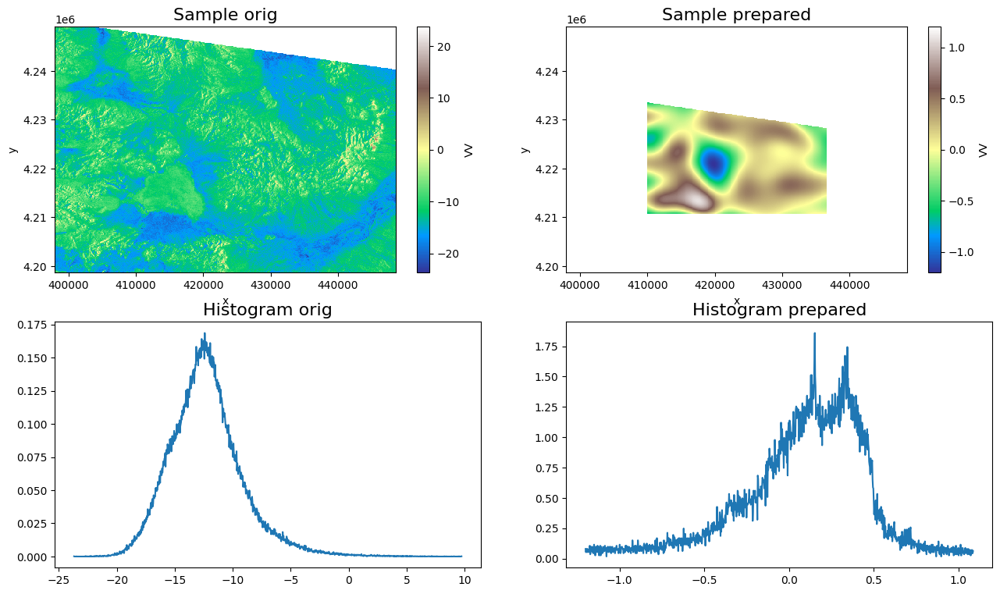

In [ ]:
fig, ((ax1,ax2),(ax3,ax4)) = plt.subplots(2, 2, figsize=(15.5, 9))

raster0.plot(ax=ax1, cmap='terrain')
ax1.set_title('Sample orig',fontsize=16)

raster.plot(ax=ax2, cmap='terrain')
ax2.set_title('Sample prepared',fontsize=16)

hist, bin_edges = np.histogram(raster0, bins=1000, density=True,
                              range=(np.nanmin(raster0.values),np.nanmax(raster0.values)))
ax3.plot(bin_edges[1:],hist)
ax3.set_title('Histogram orig',fontsize=16)

hist, bin_edges = np.histogram(raster, bins=1000, density=True,
                              range=(np.nanmin(raster.values),np.nanmax(raster.values)))
ax4.plot(bin_edges[1:],hist)
ax4.set_title('Histogram prepared',fontsize=16)

fig.subplots_adjust(hspace=0.2)
plt.show()

# Load shapefiles

### Load area

In [ ]:
area = gpd.read_file(AREA)
area

,id,name,geometry
0,0,AOI M 6.5 - Monte Cristo Range Earthquake,"POLYGON ((418279.796 4218874.676, 428311.789 4..."


In [ ]:
(minx, miny, maxx, maxy) = area.geometry[0].bounds
(minx, miny, maxx, maxy)

(418279.79557168996, 4218780.10596136, 428399.84678346815, 4228859.68112903)

### Make grid from loaded area with DEM values when provided

In [ ]:
# xArray grid
grid = raster0.sel(x=slice(minx,maxx),y=slice(maxy,miny))
dem_grid = dem.sel(x=slice(minx,maxx),y=slice(maxy,miny))
grid

<xarray.DataArray (y: 96, x: 96)>
array([[-12.18877701, -11.07148499, -12.14104599, ..., -10.62378297,
        -11.38980229, -13.09988587],
       [-11.25659039, -12.45697596, -11.08876245, ...,  -9.85109225,
        -10.41798802, -12.0642191 ],
       [-10.93388822, -11.17371883, -11.57993234, ..., -11.55611037,
        -10.29774715, -12.2711692 ],
       ...,
       [-12.92485085, -16.21370586, -16.72637015, ..., -12.52024135,
         -2.21322591,   1.89121598],
       [-13.24906858, -15.54151623, -17.61356968, ..., -12.2784273 ,
         -1.8295916 ,   0.08336255],
       [-12.20611469, -15.07372645, -17.49295435, ...,  -7.48133538,
         -1.72384916,  -0.60861818]])
Coordinates:
    band         int64 1
  * x            (x) float64 4.184e+05 4.185e+05 ... 4.282e+05 4.283e+05
  * y            (y) float64 4.229e+06 4.229e+06 ... 4.219e+06 4.219e+06
    spatial_ref  int64 0
Attributes:
    AREA_OR_POINT:  Area
    scale_factor:   1.0
    add_offset:     0.0
    long_name:      VV

In [ ]:
# use z=0 when DEM is not defined
df_grid = grid.to_dataframe('orig')
if DEM is not None:
    df_grid['z'] = dem_grid.to_dataframe('z')['z']
df_grid = df_grid.reset_index()
df_grid.head()

,y,x,band,spatial_ref,orig,z
0,4228857.5,418372.5,1,0,-12.188777,1596.944784
1,4228857.5,418477.5,1,0,-11.071485,1613.699748
2,4228857.5,418582.5,1,0,-12.141046,1637.435628
3,4228857.5,418687.5,1,0,-10.888623,1653.164537
4,4228857.5,418792.5,1,0,-12.618424,1682.580865


### Map grid

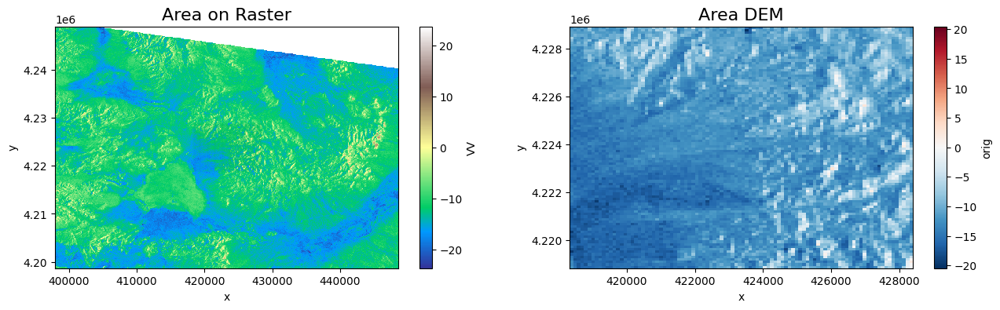

In [ ]:
fig, (ax1,ax2) = plt.subplots(1, 2, figsize=(15.5, 4))

raster0.plot(cmap='terrain', ax=ax1)
ax1.scatter(df_grid.x,df_grid.y, s=0.00001, c='red')
ax1.set_title('Area on Raster',fontsize=16)

xr.Dataset.from_dataframe(df_grid.set_index(['y','x'])[['orig']]).orig.plot(ax=ax2)
ax2.set_title('Area DEM',fontsize=16)

fig.subplots_adjust(hspace=0.15)
plt.show()

# Sample 3D volume

### Calculate statistics

In [ ]:
%%time
radius = int(round(DEPTH/(SCALE*RESOLUTION*0.707),0))
ds3d = geo3d.geo3d.compute(raster, df_grid, radius)
ds3d

CPU times: user 8.5 s, sys: 170 ms, total: 8.67 s
Wall time: 9 s


<xarray.Dataset>
Dimensions:     (y: 96, x: 96, z: 67)
Coordinates:
  * y           (y) float64 4.219e+06 4.219e+06 ... 4.229e+06 4.229e+06
  * x           (x) float64 4.184e+05 4.185e+05 ... 4.282e+05 4.283e+05
  * z           (z) float64 2.153e+03 2.079e+03 ... -2.673e+03 -2.747e+03
Data variables:
    density     (z, y, x) float32 nan nan nan nan ... 0.09732 0.09525 0.09305
    alteration  (z, y, x) float32 nan nan nan nan ... 0.1778 0.1769 0.1763
    anomaly     (z, y, x) float32 nan nan nan nan nan ... 1.87 1.827 1.857 1.894

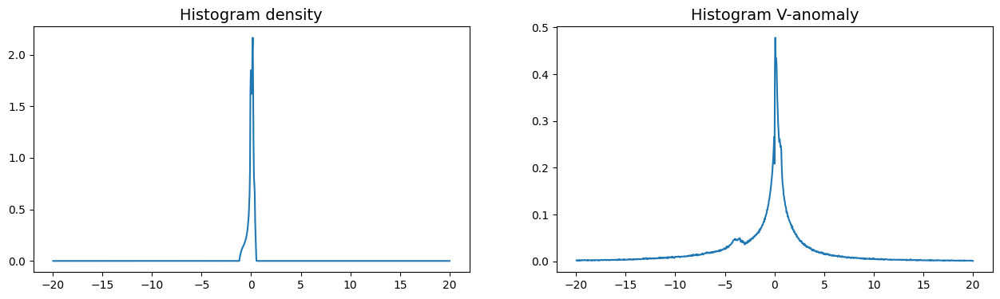

In [ ]:
fig, (ax1, ax2) = plt.subplots(1,2,figsize=(15.5, 4))

hist, bin_edges = np.histogram(ds3d.density, bins=1000, density=True,
                              range=(-20,20))
ax1.plot(bin_edges[1:],hist)
ax1.set_title('Histogram density', fontsize=14)

hist, bin_edges = np.histogram(ds3d.anomaly, bins=1000, density=True,
                              range=(-20,20))
ax2.plot(bin_edges[1:],hist)
ax2.set_title('Histogram V-anomaly', fontsize=14)

plt.show()

## Save to VTK (version 1) files

In [ ]:
if STAT != 'density':
    da = geo3d.geo3d.crop_histogram(ds3d[STAT])
else:
    da = ds3d[STAT]

da_smooth = geo3d.geo3d.idw_filter(geo3d.geo3d.median_filter(da))

/usr/local/lib/python3.10/dist-packages/geo3d/geo3d.py:262: RuntimeWarning: invalid value encountered in divide
  arr_idw = np.nansum(w * da.values.flatten()[inds[:,1:]], axis=1) / \


In [ ]:
BASENAME = os.path.splitext(os.path.basename(RASTERS.format(BAND)))[0]
BASENAME

'COPERNICUS_S1_GRD_Monte_Cristo_Before_50x50km_35m_32611'

In [ ]:
dx_km = np.diff(da.x)[0]/1000
filename = 'geo3d/data/processed/%s_b%s_gamma%.1fkm,%.1fkm.%s.vtk' % (BASENAME,BAND,dx_km*GAMMA1,dx_km*GAMMA2,STAT)
geo3d.vtk.da2vtk_scalar(da_smooth, filename)

In [ ]:
# build interactive 3D plot
plotter = pv.Plotter(notebook=True)
axes = pv.Axes(show_actor=True, actor_scale=2.0, line_width=5)

grid = pv.read(filename).rotate_x(-20, point=axes.origin).rotate_z(135, point=axes.origin)
#plotter.add_mesh(grid.outline(), color="k")
#contours = grid.contour(isosurfaces=[20,30,40,50,60,70,80], scalars="anomaly")
contours = grid.contour(isosurfaces=11, scalars="anomaly")
plotter.add_mesh(contours, opacity=0.5, cmap='rainbow', ambient=0.2, show_scalar_bar=True)

plotter.show_axes()
plotter.add_title('Interactive 3D Inversion Model', font_size=32)
#p.show(screenshot='intf.png', jupyter_backend='panel', return_viewer=True)
plotter._on_first_render_request()
panel.panel(
    plotter.render_window, orientation_widget=plotter.renderer.axes_enabled,
    enable_keybindings=False, sizing_mode='stretch_width', min_height=600
)

VTKRenderWindowSynchronized(vtkXOpenGLRenderWindow, color_mappers=[LinearColorMapper(id='a92...], min_height=600, orientation_widget=True, sizing_mode='stretch_width')